In [1]:
# %%
# Import Necessary Libraries
import os
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPooling2D, UpSampling2D, Add
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, SGD, RMSprop, Adagrad, Adadelta
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from sklearn.model_selection import train_test_split
import numpy as np
import cv2
from glob import glob
import matplotlib.pyplot as plt

# %%
# Suppress TensorFlow Logging
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"


2024-12-15 20:22:15.471371: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-15 20:22:15.611931: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-15 20:22:15.644478: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-15 20:22:15.872796: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-15 20:22:18.483325: W tensorflow/compiler/tf2

In [2]:
# %%
# Define Model Architecture (ResNet-like for Segmentation)
def conv_block(x, filters, kernel_size=(3, 3), stride=1, padding="same"):
    x = Conv2D(filters, kernel_size, strides=stride, padding=padding)(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    return x

def res_block(x, filters, stride=1):
    shortcut = x
    x = conv_block(x, filters, stride=stride)
    x = Conv2D(filters, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)

    if stride != 1 or x.shape[-1] != filters:
        shortcut = Conv2D(filters, (1, 1), strides=stride, padding="same")(shortcut)
        shortcut = BatchNormalization()(shortcut)

    x = Add()([x, shortcut])
    x = Activation("relu")(x)
    return x

def build_resnet50_for_segmentation(input_shape=(256, 256, 3), num_classes=4):
    inputs = Input(input_shape)

    # Encoder
    x = conv_block(inputs, 64, kernel_size=(7, 7), stride=2)
    x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
    x = res_block(x, 64)
    x = res_block(x, 64)
    x = res_block(x, 64)

    x = res_block(x, 128, stride=2)
    x = res_block(x, 128)
    x = res_block(x, 128)
    x = res_block(x, 128)

    x = res_block(x, 256, stride=2)
    x = res_block(x, 256)
    x = res_block(x, 256)
    x = res_block(x, 256)
    x = res_block(x, 256)
    x = res_block(x, 256)

    x = res_block(x, 512, stride=2)
    x = res_block(x, 512)
    x = res_block(x, 512)

    # Decoder
    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(256, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(128, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(64, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(32, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(num_classes, (1, 1), padding="same", activation="softmax")(x)  # Multi-class output

    return Model(inputs, x)


In [3]:
# %%
# Define Mask Remapping Function
def remap_mask_with_ranges(mask):
    remapped_mask = np.zeros_like(mask)

    # Define ranges
    background_range = (0, 50)       # Background
    gray_range = (70, 150)           # Putih keabu-abuan
    white_gray_range = (170, 230)    # Putih abu-abu
    white_range = (231, 255)         # Putih terang

    # Apply ranges
    remapped_mask[(mask >= background_range[0]) & (mask <= background_range[1])] = 0  # Background
    remapped_mask[(mask >= gray_range[0]) & (mask <= gray_range[1])] = 1  # Putih keabu-abuan
    remapped_mask[(mask >= white_gray_range[0]) & (mask <= white_gray_range[1])] = 2  # Putih abu-abu
    remapped_mask[(mask >= white_range[0]) & (mask <= white_range[1])] = 3  # Putih terang

    return remapped_mask

# %%
# Define Data Preprocessing Function
def preprocess_data(image_filenames, mask_filenames, target_size=(256, 256), num_classes=4):
    images, masks = [], []

    for img_path, mask_path in zip(image_filenames, mask_filenames):
        # Load and normalize image
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Unable to read image {img_path}. Skipping.")
            continue
        img = cv2.resize(img, target_size) / 255.0

        # Load and process mask
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if mask is None:
            print(f"Warning: Unable to read mask {mask_path}. Skipping.")
            continue
        mask = remap_mask_with_ranges(mask)
        mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        mask = tf.keras.utils.to_categorical(mask, num_classes=num_classes)

        images.append(img)
        masks.append(mask)

    return np.array(images), np.array(masks)


In [4]:
# %%
# Define Custom Metrics
def mean_iou_custom(y_true, y_pred, num_classes=4):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)
    iou = 0.0
    for c in range(num_classes):
        y_true_c = K.cast(K.equal(y_true, c), 'float32')
        y_pred_c = K.cast(K.equal(y_pred, c), 'float32')
        intersection = K.sum(y_true_c * y_pred_c)
        union = K.sum(y_true_c) + K.sum(y_pred_c) - intersection
        iou += (intersection + K.epsilon()) / (union + K.epsilon())
    return iou / num_classes

def dice_coefficient(y_true, y_pred, num_classes=4):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)
    dice = 0.0
    for c in range(num_classes):
        y_true_c = K.cast(K.equal(y_true, c), 'float32')
        y_pred_c = K.cast(K.equal(y_pred, c), 'float32')
        intersection = K.sum(y_true_c * y_pred_c)
        denominator = K.sum(y_true_c) + K.sum(y_pred_c)
        dice += (2. * intersection + K.epsilon()) / (denominator + K.epsilon())
    return dice / num_classes


In [12]:
# %%
# Load Dataset
image_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training/*'))
mask_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training_gt/*'))

# Split dataset
image_train, image_val, mask_train, mask_val = train_test_split(
    image_filenames, mask_filenames, test_size=0.2, random_state=42
)

# Preprocess data
X_train, y_train = preprocess_data(image_train, mask_train)
X_val, y_val = preprocess_data(image_val, mask_val)


In [13]:
# %%
# Train Final Model
best_learning_rate = 0.001
best_batch_size = 4
best_optimizer = Adam(learning_rate=best_learning_rate)

final_model = build_resnet50_for_segmentation(input_shape=(256, 256, 3), num_classes=4)
final_model.compile(
    optimizer=best_optimizer,
    loss=CategoricalCrossentropy(),
    metrics=["accuracy", mean_iou_custom, dice_coefficient]
)

final_callbacks = [
    EarlyStopping(monitor='val_mean_iou_custom', patience=10, restore_best_weights=True, mode='max'),
    ReduceLROnPlateau(monitor='val_mean_iou_custom', factor=0.2, patience=5, min_lr=1e-7, mode='max')
]

history_final = final_model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=50,
    callbacks=final_callbacks,
    batch_size=best_batch_size,
    verbose=1
)


Epoch 1/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 35s 79ms/step - accuracy: 0.9225 - dice_coefficient: 0.2356 - loss: 0.3946 - mean_iou_custom: 0.2309 - val_accuracy: 0.9625 - val_dice_coefficient: 0.2453 - val_loss: 0.1048 - val_mean_iou_custom: 0.2407 - learning_rate: 0.0010
Epoch 2/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 8s 62ms/step - accuracy: 0.9673 - dice_coefficient: 0.2675 - loss: 0.0824 - mean_iou_custom: 0.2561 - val_accuracy: 0.9644 - val_dice_coefficient: 0.3397 - val_loss: 0.0994 - val_mean_iou_custom: 0.2965 - learning_rate: 0.0010
Epoch 3/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 10s 79ms/step - accuracy: 0.9740 - dice_coefficient: 0.4671 - loss: 0.0647 - mean_iou_custom: 0.3930 - val_accuracy: 0.9658 - val_dice_coefficient: 0.4909 - val_loss: 0.0912 - val_mean_iou_custom: 0.4053 - learning_rate: 0.0010
Epoch 4/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - accuracy: 0.9799 - dice_coefficient: 0.5974 - loss: 0.0482 - mean_iou_custom: 0.4957 - val_accuracy: 0.9788 - val_dice_coefficient: 0.6975 - v

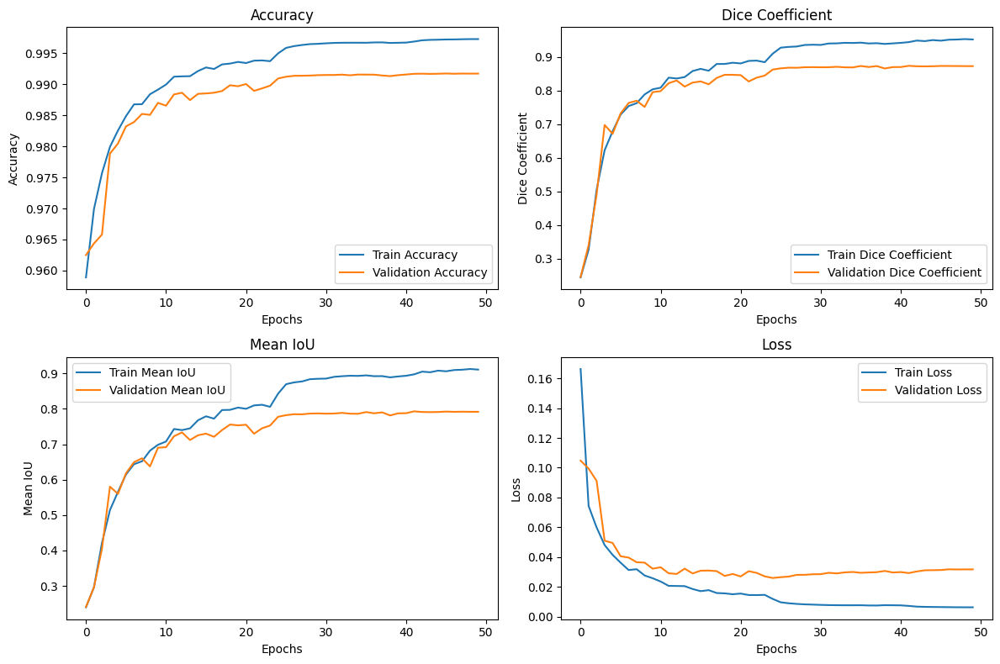

In [14]:
# %%
# Plot Metrics
history_dict = history_final.history

plt.figure(figsize=(12, 8))

# Plot Accuracy
plt.subplot(2, 2, 1)
plt.plot(history_dict['accuracy'], label='Train Accuracy')
plt.plot(history_dict['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Plot Dice Coefficient
plt.subplot(2, 2, 2)
plt.plot(history_dict['dice_coefficient'], label='Train Dice Coefficient')
plt.plot(history_dict['val_dice_coefficient'], label='Validation Dice Coefficient')
plt.title('Dice Coefficient')
plt.xlabel('Epochs')
plt.ylabel('Dice Coefficient')
plt.legend()

# Plot Mean IoU
plt.subplot(2, 2, 3)
plt.plot(history_dict['mean_iou_custom'], label='Train Mean IoU')
plt.plot(history_dict['val_mean_iou_custom'], label='Validation Mean IoU')
plt.title('Mean IoU')
plt.xlabel('Epochs')
plt.ylabel('Mean IoU')
plt.legend()

# Plot Loss
plt.subplot(2, 2, 4)
plt.plot(history_dict['loss'], label='Train Loss')
plt.plot(history_dict['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


In [15]:
# %%
def calculate_metrics(y_true, y_pred, num_classes=4):
    """
    Menghitung Mean IoU dan Dice Coefficient untuk seluruh dataset uji.
    """
    iou_list = []
    dice_list = []

    for i in range(len(y_true)):
        true_mask = np.argmax(y_true[i], axis=-1)
        pred_mask = np.argmax(y_pred[i], axis=-1)

        for c in range(num_classes):
            true_c = (true_mask == c).astype(np.float32)
            pred_c = (pred_mask == c).astype(np.float32)

            intersection = np.sum(true_c * pred_c)
            union = np.sum(true_c) + np.sum(pred_c) - intersection
            iou = (intersection + 1e-6) / (union + 1e-6)
            iou_list.append(iou)

            dice = (2 * intersection + 1e-6) / (np.sum(true_c) + np.sum(pred_c) + 1e-6)
            dice_list.append(dice)

    mean_iou = np.mean(iou_list)
    mean_dice = np.mean(dice_list)

    return mean_iou, mean_dice


In [16]:
# %%
# Adjust paths to your test dataset
image_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing/*'))
mask_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing_gt/*'))

X_test, y_test = preprocess_data(image_filenames_test, mask_filenames_test)


In [17]:
# %%
# Prediksi pada data uji
predictions_test = final_model.predict(X_test)

# Hitung metrik Mean IoU dan Dice Coefficient pada data uji
mean_iou_test, mean_dice_test = calculate_metrics(y_test, predictions_test, num_classes=4)

print(f"Test Mean IoU: {mean_iou_test:.4f}")
print(f"Test Mean Dice Coefficient: {mean_dice_test:.4f}")


8/8 ━━━━━━━━━━━━━━━━━━━━ 9s 881ms/step
Test Mean IoU: 0.6122
Test Mean Dice Coefficient: 0.7037


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


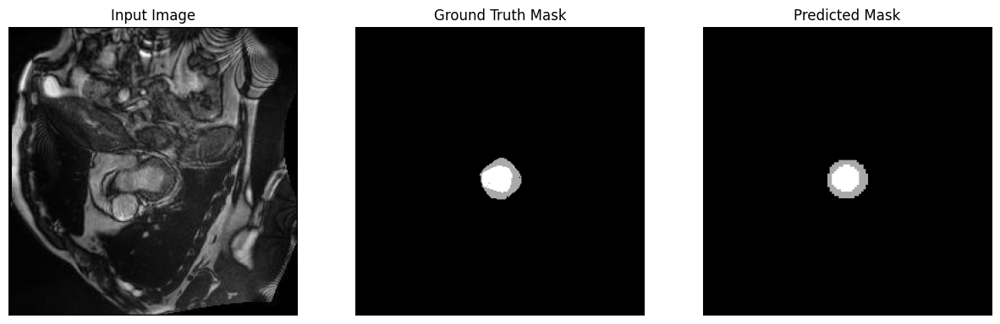

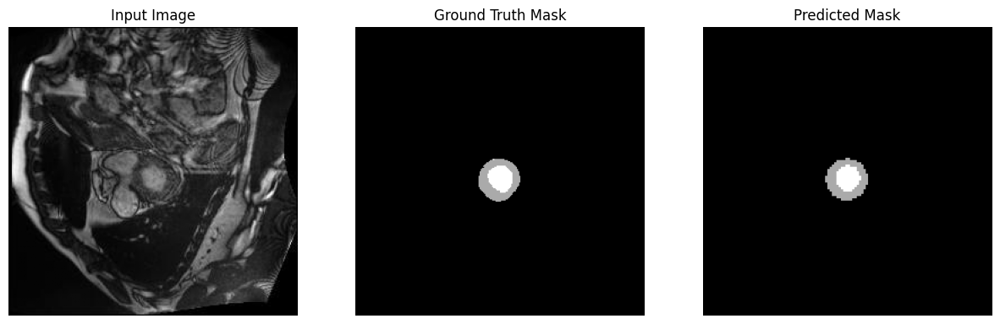

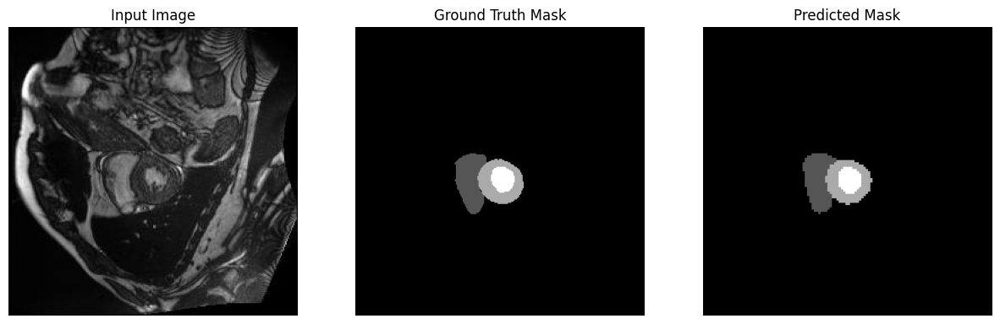

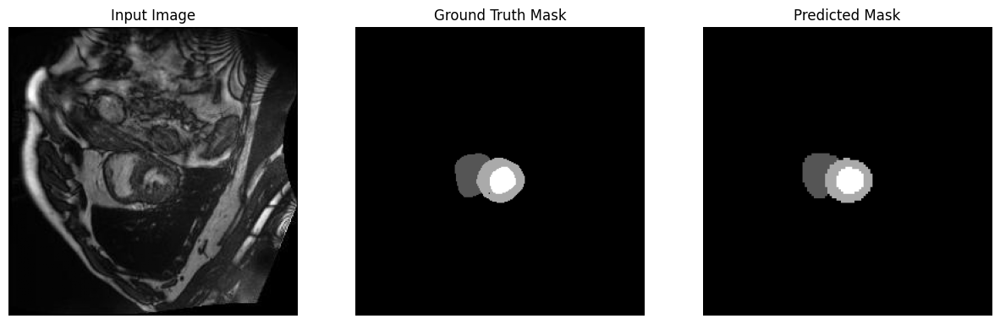

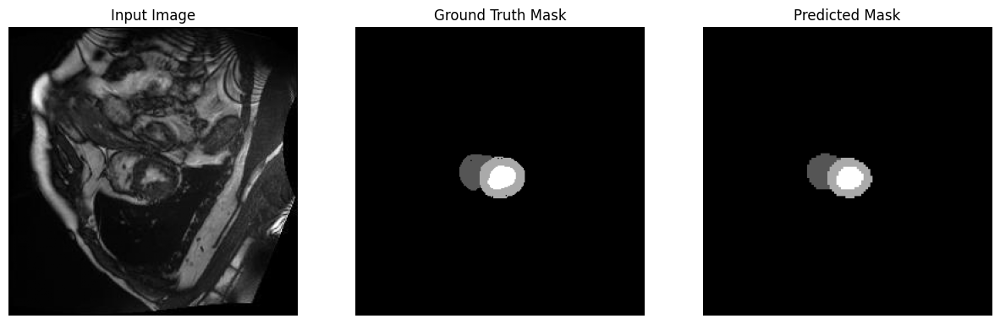

...

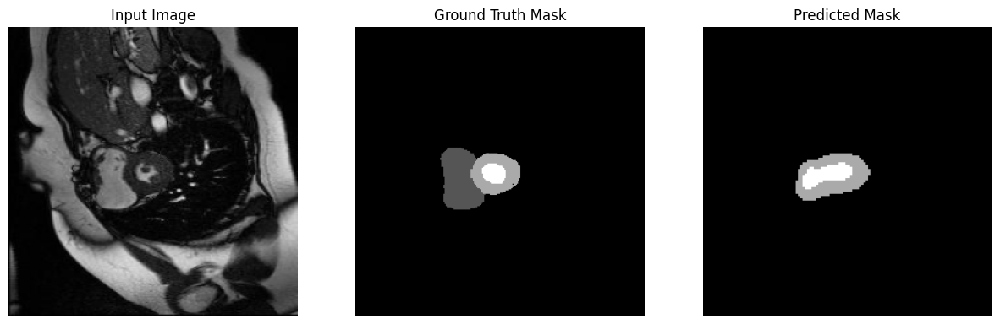

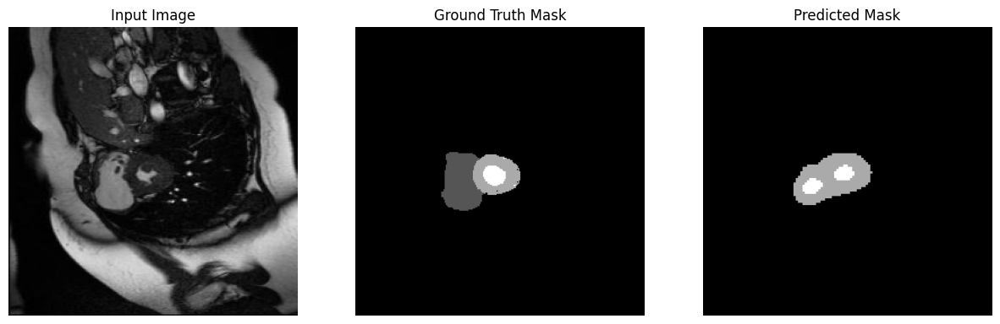

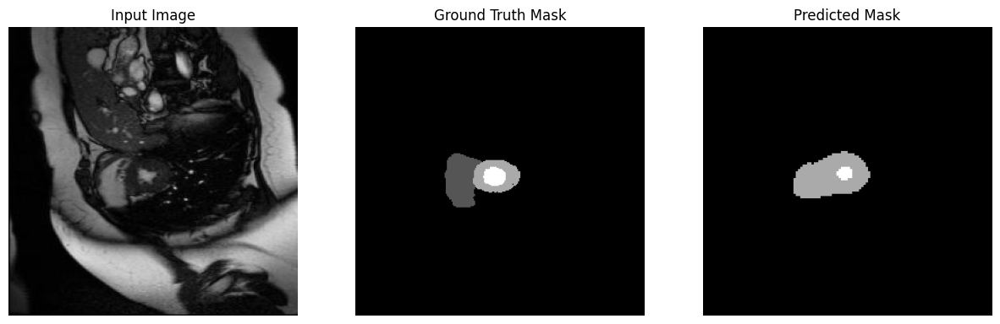

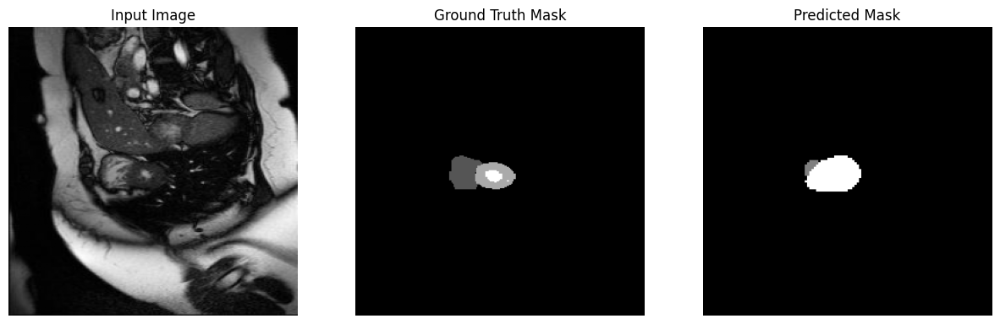

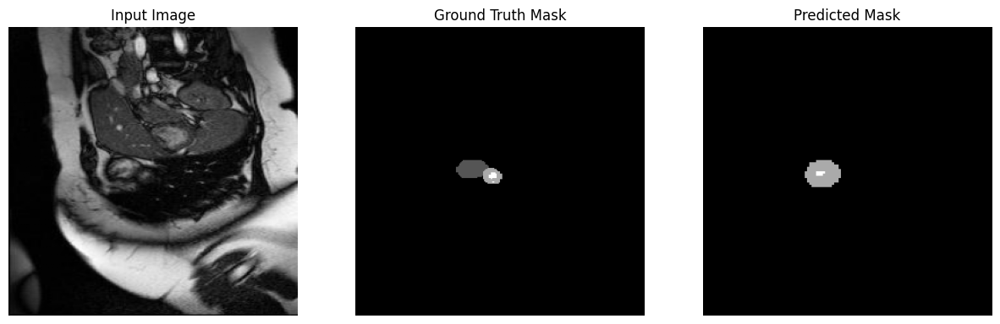

In [18]:
# %%
def visualize_predictions(model, X_test, mask_filenames, target_size=(256, 256)):
    predictions = model.predict(X_test)

    for i in range(len(X_test)):
        img = X_test[i]
        mask_path = mask_filenames[i]
        ground_truth = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if ground_truth is None:
            print(f"Warning: Unable to read mask {mask_path}. Skipping visualization for this sample.")
            continue
        ground_truth = remap_mask_with_ranges(ground_truth)
        ground_truth = cv2.resize(ground_truth, target_size, interpolation=cv2.INTER_NEAREST)
        predicted_mask = np.argmax(predictions[i], axis=-1)

        plt.figure(figsize=(15, 5))

        # Input Image
        plt.subplot(1, 3, 1)
        plt.title("Input Image")
        plt.imshow(img)
        plt.axis("off")

        # Ground Truth Mask
        plt.subplot(1, 3, 2)
        plt.title("Ground Truth Mask")
        plt.imshow(ground_truth, cmap="gray")
        plt.axis("off")

        # Predicted Mask
        plt.subplot(1, 3, 3)
        plt.title("Predicted Mask")
        plt.imshow(predicted_mask, cmap="gray")
        plt.axis("off")

        plt.show()

# Panggil fungsi visualisasi
visualize_predictions(final_model, X_test, mask_filenames_test)
